# Analysis of assign-placenames robot

This notebook is an experiment to see if the code in SDR's accessioning pipeline that assigns [GeoNames](https://www.geonames.org/) IDs to places can be improved by looking up places in an external service. See [#744](https://github.com/sul-dlss/gis-robot-suite/issues/744) for the context.

The approach so far has been to maintain a static mapping of place names to GeoNames IDs. But this mapping has not been updated because the workflow doesn't surface when a place fails to match. Over the past few months we've had [462 place names fail lookup](https://github.com/sul-dlss/gis-robot-suite/issues/717) and it isn't feasible to try to enter these, or keep the CSV up to date going forward.

This notebook will use the existing mapping to see if we can find the corresponding GeoNames ID via an API. Since there isn't any facility in the workflow for selecting the correct match from a set of results, the first match will be used to determine the success or failure of the lookup. A given lookup result in the following:

1. *Correct*: the same GeoNames ID is found 🎉
2. *False Positive*: a GeoNames ID is found, but it's not the right one
3. *False Negative*: no GeoNames ID is found, but there is one

## The Gazetteer Mapping

The [existing code](https://github.com/sul-dlss/gis-robot-suite/blob/main/lib/gis_robot_suite/gazetteer.rb#L42-L48) uses the value in the `l_kw` column to find matches when `find_placename_uri()` is called. There appears to be a fallback to compare against `geonames_kw` in cases where `l_kw` is empty, but there aren't any rows in the current `gazetteer.csv` where that's the case. The `lc_kw` and `lc_id` columns are no longer being used.

Lets load the mapping into a DataFrame:

In [13]:
import pandas

gaz = pandas.read_csv('gazetteer.csv', dtype={'geonames_id': str})
gaz

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id
0,Accra (Ghana),Accra,2306104,Accra (Ghana),n79059515
1,Acholi District (Uganda),Acholi District,235527,NaN,NaN
2,"Adampur (Haryana, India)",Adampur,7646705,NaN,NaN
3,Addis Ababa (Ethiopia),Addis Ababa,344979,Addis Ababa (Ethiopia),n79061184
4,Adilabad (India : District),Ādilābād,1279345,Adilabad (India : District),n2007200836
...,...,...,...,...,...
1726,Zambia,Zambia,895949,Zambia,n80089997
1727,Zhejiang Sheng (China),Zhejiang Sheng,1784764,Zhejiang Sheng (China),n81023097
1728,Zhengzhou (China),Zhengzhou,1784658,Zhengzhou (China),n2008049243
1729,Zugdidi (Georgia),Zugdidi,610824,Zugdidi (Georgia),n2009016643


For this checking we just need the name and the GeoNames ID.

In [14]:
gaz = gaz[['l_kw', 'geonames_id']]
gaz.columns = ['name', 'geonames_id']
gaz


,name,geonames_id
0,Accra (Ghana),2306104
1,Acholi District (Uganda),235527
2,"Adampur (Haryana, India)",7646705
3,Addis Ababa (Ethiopia),344979
4,Adilabad (India : District),1279345
...,...,...
1726,Zambia,895949
1727,Zhejiang Sheng (China),1784764
1728,Zhengzhou (China),1784658
1729,Zugdidi (Georgia),610824


## GeoNames Webservice

GeoNames has a web service, let's see how many of the names match the correct GeoNames ID, starting with a query using their [search endpoint](http://www.geonames.org/export/index.html#fulltextSearch). I'm using a normal guest account which is limited to 1000 queries per day.

In [19]:
import json
import requests

results = requests.get('https://secure.geonames.org/search', params={
    "q": "New York City",
    "username": "edsu",
    "type": "json"
}).json()

print(len(results['geonames']))

100


It returns 100 results by default. This is a fulltext search, and hopefully the first result is the best? The lookups need to be automated if they are going to be part of the SDR workflow.

In [21]:
results['geonames'][0]

{'adminCode1': 'NY',
 'lng': '-74.00597',
 'geonameId': 5128581,
 'toponymName': 'New York City',
 'countryId': '6252001',
 'fcl': 'P',
 'population': 8804190,
 'countryCode': 'US',
 'name': 'New York',
 'fclName': 'city, village,...',
 'adminCodes1': {'ISO3166_2': 'NY'},
 'countryName': 'United States',
 'fcodeName': 'populated place',
 'adminName1': 'New York',
 'lat': '40.71427',
 'fcode': 'PPL'}

This looks good. Since we have more than 1000 rows in the gazetteer lets sample 50 of them and see how well the first match works.

In [24]:
gaz_50 = gaz.sample(50)
gaz_50

,name,geonames_id
447,Dharmanagar (India),1272852
1522,Surendranagar (India : District),1255350
1572,Three Rivers (England),2635925
1289,Reotīpur (India),1258202
1614,Upputeru River,1253709
1710,Wycombe (England : District),2633462
473,Durg (India),1272181
479,East Cambridgeshire (England),2650488
839,"La Paz (Baja California Sur, Mexico)",4000900
985,Meurthe-et-Moselle (France),2994111


Now we'll create a function that looks them up.

In [50]:
import time

def geonames_lookup(name):
    time.sleep(.5) # to avoid a rate limit
    response = requests.get('https://secure.geonames.org/search', params={
        "q": name,
        "username": "edsu",
        "type": "json"
    })
    response.raise_for_status()

    results = response.json()['geonames']
    if len(results) > 0:
        return str(results[0]['geonameId'])
    else:
        return None
    
geonames_lookup('New York City')

'5128581'

Now we can add a column to our sample for the looked up GeoNames ID by mapping the names with the `geonames_lookup` function:

In [53]:
gaz_50['geonames_id_lookup'] = gaz_50.name.map(geonames_lookup)
gaz_50

,name,geonames_id,geonames_id_lookup
447,Dharmanagar (India),1272852,1272852
1522,Surendranagar (India : District),1255350,1255350
1572,Three Rivers (England),2635925,5280975
1289,Reotīpur (India),1258202,1258202
1614,Upputeru River,1253709,1253709
1710,Wycombe (England : District),2633462,2633462
473,Durg (India),1272181,1272181
479,East Cambridgeshire (England),2650488,2650023
839,"La Paz (Baja California Sur, Mexico)",4000900,4000900
985,Meurthe-et-Moselle (France),2994111,2994111


So what do our results look like:

* false negatives: no GeoNames ID was found
* false positive: a GeoNames ID was found but it wasn't the one we expected
* correct: the expected GeoNamesID was found

Creating some functions to return these given a column name to examine will make it easier to calculate these for other results.

In [73]:
def false_negatives(df, col):
    return len(df[df[col].isnull()]) / len(df)

false_negatives(gaz_50, 'geonames_id_lookup')

0.04

In [74]:
def false_positives(df, col):
    return len(df[df[col].notnull() & (df.geonames_id != df[col])]) / len(df)

false_positives(gaz_50, 'geonames_id_lookup')

0.38

In [75]:
def correct(df, col):
    return len(df[df.geonames_id == df[col]]) / len(df)

correct(gaz_50, 'geonames_id_lookup')

0.58

In [78]:
def stats(df, col):
    print(f"correct={correct(df, col)} false_negatives={false_negatives(df, col)} false_positives={false_positives(df, col)}")

stats(gaz_50, 'geonames_id_lookup')

correct=0.58 false_negatives=0.04 false_positives=0.38


It wouldn't be possible to go to production with this!

### Query Tuning

Lets look at one of the false negatives and see if we can figure out why it didn't match correctly. 

Southampton (England) should have resulted in `3333196`:

In [71]:
geonames_lookup('Southampton (England)')

'2637487'

Here are the GeoNames entities:

* correct: https://www.geonames.org/3333196/southampton.html - A ADM2 second-order administrative division 
* incorrect: https://www.geonames.org/2637487/southampton.html - P PLA2 seat of a second-order administrative division

What if we modify our lookup to limit to [A Feature Classes](https://www.geonames.org/export/codes.html)?

In [80]:
def geonames_lookup2(name):
    time.sleep(.5) # to avoid a rate limit
    response = requests.get('https://secure.geonames.org/search', params={
        "q": name,
        "username": "edsu",
        "type": "json",
        "featureClass": "A"
    })
    response.raise_for_status()

    results = response.json()['geonames']
    if len(results) > 0:
        return str(results[0]['geonameId'])
    else:
        return None

geonames_lookup2("Southampton (England)")

'3333196'

Ok, that's the right GeoNames ID. How does it work on our sample?

In [76]:
gaz_50['geonames_id_lookup2'] = gaz_50.name.map(geonames_lookup2)

In [79]:
stats(gaz_50, 'geonames_id_lookup2')

correct=0.4 false_negatives=0.26 false_positives=0.34


That's arguably worse than what we got before `correct=0.58 false_negatives=0.04 false_positives=0.38`

How about if we prefer Feature Class `P` then `A`?

In [93]:
def geonames_lookup3(name):
    time.sleep(.5) # to avoid a rate limit
    response = requests.get('https://secure.geonames.org/search', params={
        "q": name,
        "username": "edsu",
        "type": "json",
        "featureClass": ["P", "A"]
    })
    response.raise_for_status()

    results = response.json()['geonames']
    if len(results) > 0:
        return str(results[0]['geonameId'])
    else:
        return None

geonames_lookup2("Southampton (England)")

'3333196'

In [94]:
gaz_50['geonames_id_lookup3'] = gaz_50.name.map(geonames_lookup3)
stats(gaz_50, 'geonames_id_lookup3')

correct=0.5 false_negatives=0.16 false_positives=0.34


That's slightly better than just `A`, but still not as good as not specifying it at all...

### Inspecting the matches

Is the correct ID even in the first 100 search results?

In [89]:
results = requests.get('https://secure.geonames.org/search', params={
    "q": "Southampton (England)",
    "username": "edsu",
    "type": "json",
}).json()['geonames']

3333196 in [r['geonameId'] for r in results]

True

It is there, so lets see if we can figure out a heuristic for picking it out from the others:

In [92]:
for r in results:
    print()
    print(json.dumps(r, indent=2))
    if r['geonameId'] == 3333196:
        break
    


{
  "adminCode1": "ENG",
  "lng": "-1.40428",
  "geonameId": 2637487,
  "toponymName": "Southampton",
  "countryId": "2635167",
  "fcl": "P",
  "population": 269781,
  "countryCode": "GB",
  "name": "Southampton",
  "fclName": "city, village,...",
  "adminCodes1": {
    "ISO3166_2": "ENG"
  },
  "countryName": "United Kingdom",
  "fcodeName": "seat of a second-order administrative division",
  "adminName1": "England",
  "lat": "50.90395",
  "fcode": "PPLA2"
}

{
  "adminCode1": "ENG",
  "lng": "-1.3568",
  "geonameId": 6296592,
  "toponymName": "Southampton / Weather Centre",
  "countryId": "2635167",
  "fcl": "S",
  "population": 0,
  "countryCode": "GB",
  "name": "Southampton Airport",
  "fclName": "spot, building, farm",
  "adminCodes1": {
    "ISO3166_2": "ENG"
  },
  "countryName": "United Kingdom",
  "fcodeName": "airport",
  "adminName1": "England",
  "lat": "50.95026",
  "fcode": "AIRP"
}

{
  "adminCode1": "ENG",
  "lng": "-1.38333",
  "geonameId": 3333196,
  "toponymName": 

We could easily ignore the name "Southampton Airport". But it doesn't appear that there is any way of distinguishing the first and third result using just the name.

### Is It Good Enough?

In this case the two Southampton entities are roughly in the same geographic location: 

#### Correct

https://www.geonames.org/3333196/southampton.html - [50.91667, -1.38333](http://www.openstreetmap.org/?mlat=50.91667&mlon=-1.38333&zoom=11)

[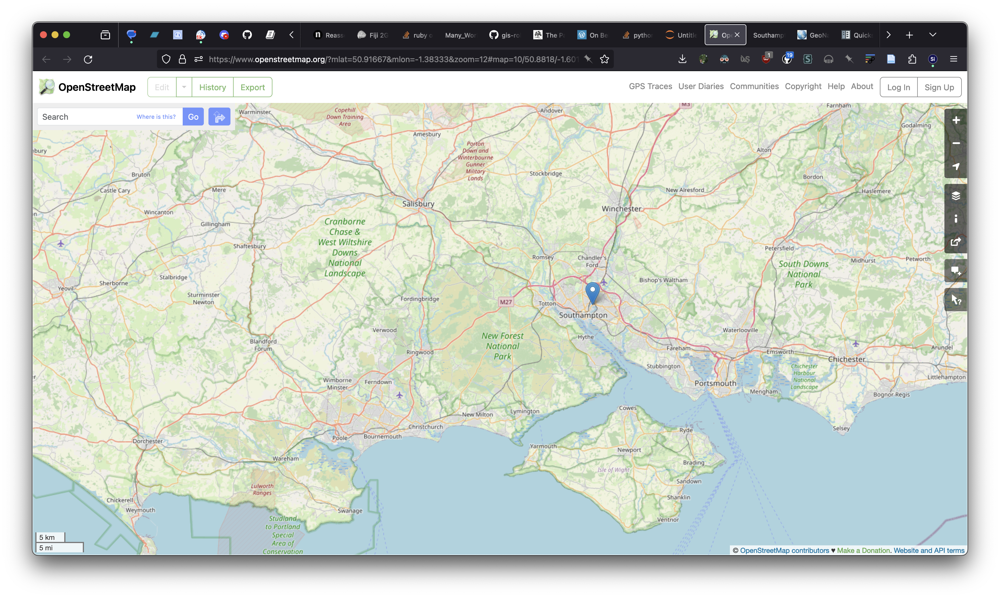](http://www.openstreetmap.org/?mlat=50.91667&mlon=-1.38333&zoom=11)

#### Incorrect

https://www.geonames.org/2637487/southampton.html - [50.90395, -1.40428](http://www.openstreetmap.org/?mlat=50.90395&mlon=-1.40428&zoom=11)

[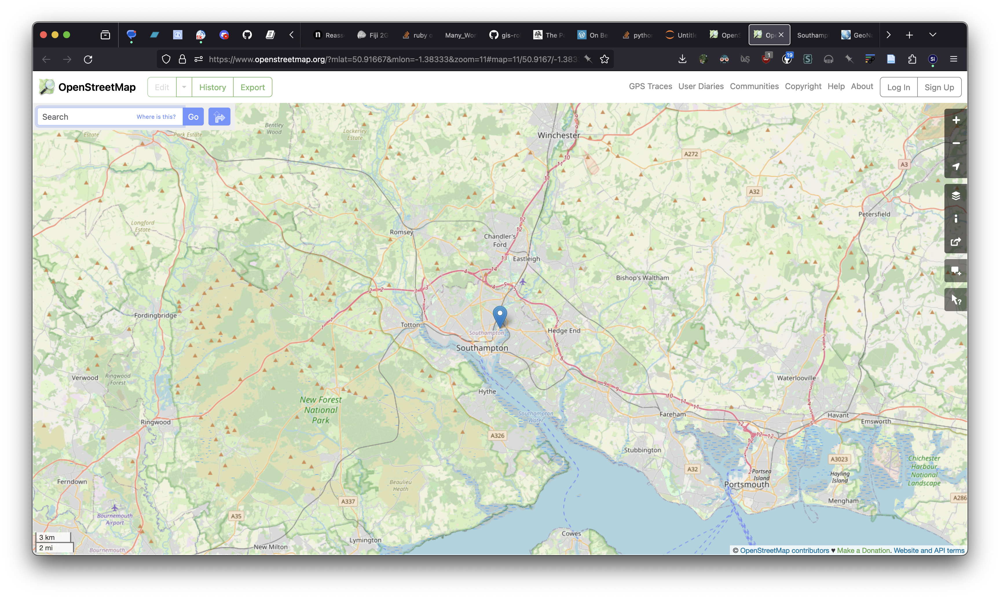](http://www.openstreetmap.org/?mlat=50.90395&mlon=-1.40428&zoom=11)

Which begs the question of whether the GeoName ID that we found is "good enough"?

Maybe it will be helpful if we calculate the *distance* between the correct GeoName ID and the one that was found. To do that we need the coordinates of both.

In [98]:
from geopy.distance import geodesic

geodesic((50.91667, -1.38333), (50.90395, -1.40428))

Distance(2.0429175654922607)

That's just over 2 km.

Lets calculate it for our sample, first pruning away unneeded columns.

In [101]:
gaz_50 = gaz_50[['name', 'geonames_id', 'geonames_id_lookup']]

In [138]:
import xml.etree.ElementTree as ET

def get_coordinates(geonames_id):
    time.sleep(.5)
    response = requests.get('https://secure.geonames.org/get', params={"geonameId": geonames_id, "username": "edsu"})
    if response.status_code != 200:
        return None
    doc = ET.fromstring(response.text)
    return (doc.findtext('./lat'), doc.findtext('./lng'))
    
get_coordinates('3333196')

('50.91667', '-1.38333')

In [139]:
gaz_50['geo'] = gaz_50.geonames_id.map(get_coordinates)

In [140]:
gaz_50.head(5)

,name,geonames_id,geonames_id_lookup,geo
447,Dharmanagar (India),1272852,1272852,"(24.36667, 92.16667)"
1522,Surendranagar (India : District),1255350,1255350,"(22.75, 71.66667)"
1572,Three Rivers (England),2635925,5280975,"(51.6702, -0.45095)"
1289,Reotīpur (India),1258202,1258202,"(25.5373, 83.71252)"
1614,Upputeru River,1253709,1253709,"(17.68333, 83.28333)"


In [141]:
gaz_50['geo_lookup'] = gaz_50.geonames_id_lookup.map(get_coordinates)
gaz_50.head(5)

,name,geonames_id,geonames_id_lookup,geo,geo_lookup
447,Dharmanagar (India),1272852,1272852,"(24.36667, 92.16667)","(24.36667, 92.16667)"
1522,Surendranagar (India : District),1255350,1255350,"(22.75, 71.66667)","(22.75, 71.66667)"
1572,Three Rivers (England),2635925,5280975,"(51.6702, -0.45095)","(42.1812, -72.36064)"
1289,Reotīpur (India),1258202,1258202,"(25.5373, 83.71252)","(25.5373, 83.71252)"
1614,Upputeru River,1253709,1253709,"(17.68333, 83.28333)","(17.68333, 83.28333)"


In [144]:
gaz_50['distance'] = gaz_50.apply(lambda r: geodesic(r.geo, r.geo_lookup), axis=1)
gaz_50

,name,geonames_id,geonames_id_lookup,geo,geo_lookup,distance
447,Dharmanagar (India),1272852,1272852,"(24.36667, 92.16667)","(24.36667, 92.16667)",0.0 km
1522,Surendranagar (India : District),1255350,1255350,"(22.75, 71.66667)","(22.75, 71.66667)",0.0 km
1572,Three Rivers (England),2635925,5280975,"(51.6702, -0.45095)","(42.1812, -72.36064)",5349.429296035288 km
1289,Reotīpur (India),1258202,1258202,"(25.5373, 83.71252)","(25.5373, 83.71252)",0.0 km
1614,Upputeru River,1253709,1253709,"(17.68333, 83.28333)","(17.68333, 83.28333)",0.0 km
1710,Wycombe (England : District),2633462,2633462,"(51.58333, -0.9)","(51.58333, -0.9)",0.0 km
473,Durg (India),1272181,1272181,"(21.19147, 81.27619)","(21.19147, 81.27619)",0.0 km
479,East Cambridgeshire (England),2650488,2650023,"(52.31667, 0.3)","(52.39964, 0.26196)",9.589262074919665 km
839,"La Paz (Baja California Sur, Mexico)",4000900,4000900,"(24.14231, -110.31316)","(24.14231, -110.31316)",0.0 km
985,Meurthe-et-Moselle (France),2994111,2994111,"(48.65082, 6.1566)","(48.65082, 6.1566)",0.0 km


How many of our expected and discovered locations more than 100 km apart, where we know their geo coordinates:

In [149]:
gaz_50[gaz_50.geo.notnull() & gaz_50.geo_lookup.notnull() & (gaz_50.distance > 100)]

,name,geonames_id,geonames_id_lookup,geo,geo_lookup,distance
1572,Three Rivers (England),2635925,5280975,"(51.6702, -0.45095)","(42.1812, -72.36064)",5349.429296035288 km
793,Khanapur (India),1445119,1267065,"(17.28417, 78.06472)","(15.63969, 74.50847)",421.08820228234737 km
1558,Telford & Wrekin (England),3333209,None,"(52.75, -2.5)","(None, None)",5851.440713044112 km
1515,Sultānpur (India : District),1255489,1255491,"(29.75534, 78.11034)","(26.25788, 82.07269)",549.5503893642458 km
47,American Canyon (Calif.),5323694,5333944,"(38.17492, -122.2608)","(34.42333, -118.47203)",537.5793124891701 km
1532,Sydney (N.S.W.),2147714,None,"(-33.86785, 151.20732)","(None, None)",15210.135811113883 km


That is a 6/50 (12%) error rate which still really isn't that good :(

## id.loc.gov

Maybe this has been going the wrong direction. It looks like all the names that are being looked might be Library of Congress Name Authorities? If that's the case there's a way to look those up now, and they may have links to GeoNames IDs.

In [3]:
gaz = pandas.read_csv('gazetteer.csv', dtype={'geonames_id': str})
gaz

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id
0,Accra (Ghana),Accra,2306104,Accra (Ghana),n79059515
1,Acholi District (Uganda),Acholi District,235527,NaN,NaN
2,"Adampur (Haryana, India)",Adampur,7646705,NaN,NaN
3,Addis Ababa (Ethiopia),Addis Ababa,344979,Addis Ababa (Ethiopia),n79061184
4,Adilabad (India : District),Ādilābād,1279345,Adilabad (India : District),n2007200836
...,...,...,...,...,...
1726,Zambia,Zambia,895949,Zambia,n80089997
1727,Zhejiang Sheng (China),Zhejiang Sheng,1784764,Zhejiang Sheng (China),n81023097
1728,Zhengzhou (China),Zhengzhou,1784658,Zhengzhou (China),n2008049243
1729,Zugdidi (Georgia),Zugdidi,610824,Zugdidi (Georgia),n2009016643


Are there any `l_kw` values that don't match the `lc_kw`?

In [4]:
gaz[gaz.lc_kw.notnull() & (gaz.l_kw != gaz.lc_kw)]

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id
32,Alībāg (India),Alībāg,1279027,Alibag (India),n89265169
197,Bhākra Dam,Bhākra Dam,1276238,Bhakra Dam (India),sh99002611
253,Bournemouth,Bournemouth,3333129,Bournemouth (England),n80079500
374,Ciudad Juárez (Mexico),Ciudad Juárez,4013708,Ciudad Juarez (Mexico),n82000742
765,Kandahar (Afghanistan),Kandahar,1138336,Kandahār (Afghanistan),n83042981
831,Kunduz (Afghanistan),Kunduz,1135690,Kundūz (Afghanistan),n87929913
1443,Sīwan (India),Sīwan,1255927,"Siwān (Saran, India)",no89000014
1508,Suisun (Calif.),Suisun,5399629,Suisun City (Calif.),n85046894


Only a handful. So we can assume that these names are sourced from the Library of Congress Name Authority file for the most part?

Lets spot check some of these to see if the string we are looking up matches the name in the LC Name Authority File record. For now can scrape the authorized label out of the HTML.

In [19]:
import re
import time
import requests

def lc_name(lc_id):
    if lc_id is None:
        return None
        
    time.sleep(.5) # don't accidentally DDoS id.loc.gov
    url = f"https://id.loc.gov/authorities/names/{lc_id}.html"
    resp = requests.get(url)

    if resp.status_code == 404:
        return None
    elif m := re.search('<span property="madsrdf:authoritativeLabel skos:prefLabel">(.+)</span>', resp.text):
        return m.group(1)
    else: 
        return None

lc_name('n81097506')

'San Joaquin County (Calif.)'

In [20]:
gaz_50 = gaz.sample(50)
gaz_50.head(5)

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id
587,Guangxi Zhuangzu Zizhiqu (China),Guangxi Zhuangzu Zizhiqu,1809867,Guangxi Zhuangzu Zizhiqu (China),n80138721
1235,Ponnāni (India),Ponnāni,1259411,NaN,NaN
54,Andhāri (India),Andhāri,1278638,NaN,NaN
1340,Saint-Martin (Collectivity),Saint-Martin,3578421,Saint-Martin (Collectivity),no2008109008
476,"Ealing (London, England)",Ealing,3333145,"Ealing (London, England)",n81148224


In [ ]:
gaz_50['lc_name'] = gaz_50.lc_id.map(lc_name)

In [22]:
gaz_50

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id,lc_name
587,Guangxi Zhuangzu Zizhiqu (China),Guangxi Zhuangzu Zizhiqu,1809867,Guangxi Zhuangzu Zizhiqu (China),n80138721,Guangxi Zhuangzu Zizhiqu (China)
1235,Ponnāni (India),Ponnāni,1259411,NaN,NaN,None
54,Andhāri (India),Andhāri,1278638,NaN,NaN,None
1340,Saint-Martin (Collectivity),Saint-Martin,3578421,Saint-Martin (Collectivity),no2008109008,Saint Martin (Collectivity)
476,"Ealing (London, England)",Ealing,3333145,"Ealing (London, England)",n81148224,"Ealing (London, England)"
1334,Saharsa (India),Saharsa,1257805,NaN,NaN,None
600,Guyana,Guyana,3378535,Guyana,n80061018,Guyana
1249,Prunedale (Calif.),Prunedale,5385082,Prunedale (Calif.),n81006388,Prunedale (Calif.)
48,Amrāvati (India : District),Amrāvati,1278719,Amrāvati (India : District),no2005000085,Amrāvati (India : District)
1569,Thānga (India),Thānga,1254656,NaN,NaN,None


So what percentage of our sample had strings that matched?

In [27]:
len(gaz_50[gaz_50.l_kw == gaz_50.lc_name]) / len(gaz_50)

0.76

That includes rows without an LC authority. How many rows have a matching LC Name Authority?

In [29]:
gaz_50_lc = gaz_50[gaz_50.lc_id.notnull()]
len(gaz_50_lc)

42

And how many of these have matching names (in our lookup name, and the authorized LC Name Authority heading)?

In [30]:
len(gaz_50_lc[gaz_50_lc.l_kw == gaz_50_lc.lc_name]) / len(gaz_50_lc)

0.9047619047619048

So most of them match? Which ones don't?

In [32]:
gaz_50_lc[gaz_50_lc.l_kw != gaz_50_lc.lc_name]

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id,lc_name
1340,Saint-Martin (Collectivity),Saint-Martin,3578421,Saint-Martin (Collectivity),no2008109008,Saint Martin (Collectivity)
1074,Narmada River (India),Narmada,1261774,Narmada River (India),sh85089828,None
893,Lucia (Calif.),Lucia,5369159,Lucia (Calif.),sh85117377,None
191,Betwa River (India),Betwa River,1276386,Betwa River (India),sh90000804,None


Ah, there are some that failed to lookup because our `lc_id` is for a Subject Authority and not a name authority. Presumably those are mistakes?

Lets analyze the entire gazetteer now to see how many have LC Name Authority records, and whether the names match.

In [40]:
gaz['lc_name'] = gaz.lc_id.map(lc_name)

How many have LC names that are not None?

In [38]:
gaz

,l_kw,geonames_kw,geonames_id,lc_kw,lc_id,None
0,Accra (Ghana),Accra,2306104,Accra (Ghana),n79059515,Accra (Ghana)
1,Acholi District (Uganda),Acholi District,235527,NaN,NaN,None
2,"Adampur (Haryana, India)",Adampur,7646705,NaN,NaN,None
3,Addis Ababa (Ethiopia),Addis Ababa,344979,Addis Ababa (Ethiopia),n79061184,Addis Ababa (Ethiopia)
4,Adilabad (India : District),Ādilābād,1279345,Adilabad (India : District),n2007200836,Adilabad (India)
...,...,...,...,...,...,...
1726,Zambia,Zambia,895949,Zambia,n80089997,Zambia
1727,Zhejiang Sheng (China),Zhejiang Sheng,1784764,Zhejiang Sheng (China),n81023097,Zhejiang Sheng (China)
1728,Zhengzhou (China),Zhengzhou,1784658,Zhengzhou (China),n2008049243,Zhengzhou (China)
1729,Zugdidi (Georgia),Zugdidi,610824,Zugdidi (Georgia),n2009016643,Zugdidi (Georgia)


## Existing Descriptive Metadata

To get a sense of how well the assign-placenames task has been working, I used Argo's bulk actions to generate a CSV file of descriptive metadata for GIS items (22,404).

How many of these actually had GeoNames IDs assigned?

## Summary

In part it feels like this analysis has been attempting to reconstruct the business logic that was intended by the place-names task in the gis-robot-suite codebase. Why was the assign-placenames robot created and what value does it offer? The [commit history](https://github.com/sul-dlss/gis-robot-suite/commits/18ea0b56a5f9c886e2823702c6d3907dab1d841e/robots/gisAssembly/assign-placenames.rb?browsing_rename_history=true&new_path=lib/robots/dor_repo/gis_assembly/assign_placenames.rb&original_branch=18ea0b56a5f9c886e2823702c6d3907dab1d841e) for the task (prior to it be renamed) doesn't reveal a whole lot, and the original author of the code is no longer with SUL.

We know from Kim that there was some desire at the time (~10 years ago) to do something with GIS and Linked Data, and that using GeoNames IDs might provide some value. But this benefit has been unrealized since so few items have assigned GeoNames IDs, and there doesn't appear to be any functionality in access systems (PURL, SearchWorks, EarthWorks) that uses the GeoNames IDs.

Furthermore, the landscape has changed a bit in the intervening years in that places like Wikidata exist with a lot more data than what is available in GeoNames. One could imagine functionality in GeoBlacklight (EarthWorks) that layered information about places into the display using a WikiData ID. But that functionality does not currently exist.

It is clear that the approach to adding GeoNames hasn't been sustainable because we haven't been able to manage the Gazetteer CSV that controls the mapping of names to GeoNames IDs. Unfortunately it doesn't appear to be possible to automatically look up place names in GeoNames API because, based on a sample (n=50):

- correct ID found: 58%
- not found (false negatives): 4%
- incorrect ID was found (false positives): 38%

Without a human in the loop reviewing these it wouldn't be sustainable to look them up automatically in GeoNames.

However since the majority of the Gazetteer Mapping table appears to be mapping LC Name Authority place names, perhaps what we could consider doing in assign-placenames is looking up the name in the Library of Congress Name Authority file (a web API call). If an exact match is not found, then a workflow error will be raised. If a match is found, then we add the LC Name Authority ID to the subject in Cocina. The value here would be that:

1. We have some consistency in the data so like items will colocate, when users facet in SearchWorks, etc.
2. The LC Name Authority ID is increasingly linked to other places, and can be found in Wikidata. So it could be a good way to bring in additional metadata about places in environments like GeoBlacklight.

